In [1]:
import networkx as nx
G = nx.karate_club_graph()
# Compute the Laplacian matrix
L = nx.laplacian_matrix(G).astype(float).toarray()

In [2]:
import numpy as np
# Compute the first 2 eigenvectors
eigvals, eigvecs = np.linalg.eigh(L)
eigvecs = eigvecs[:, :2]
print(eigvals[:8])

[-3.46958714e-15  1.18710730e+00  2.39431926e+00  2.93182048e+00
  2.96830180e+00  3.06104079e+00  3.12126310e+00  3.70606484e+00]


In [3]:
from sklearn.cluster import KMeans
# Apply k-means clustering
kmeans = KMeans(n_clusters=2)
labels = kmeans.fit_predict(eigvecs)

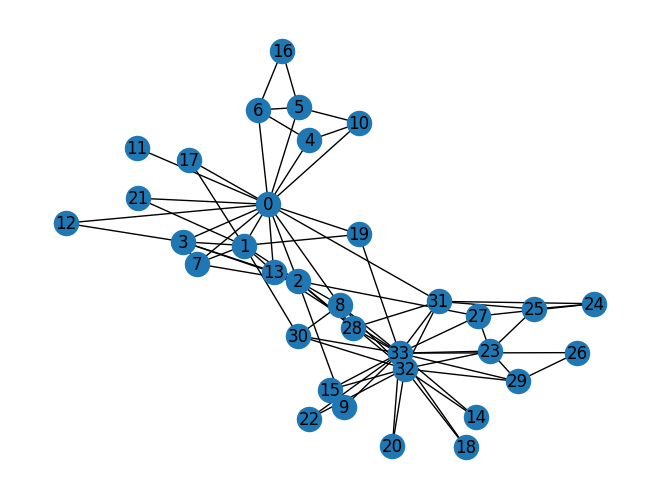

In [4]:
import matplotlib.pyplot as plt

# Load the Zachary's Karate Club network
G = nx.karate_club_graph()

# Visualize the network
pos = nx.spring_layout(G, seed=42)
nx.draw(G, pos, with_labels=True)
plt.show()

In [5]:
# Print the node attributes
print("Node attributes:")
print(G.nodes(data=True))

# Print the edge attributes
print("\nEdge attributes:")
print(G.edges(data=True))

Node attributes:
[(0, {'club': 'Mr. Hi'}), (1, {'club': 'Mr. Hi'}), (2, {'club': 'Mr. Hi'}), (3, {'club': 'Mr. Hi'}), (4, {'club': 'Mr. Hi'}), (5, {'club': 'Mr. Hi'}), (6, {'club': 'Mr. Hi'}), (7, {'club': 'Mr. Hi'}), (8, {'club': 'Mr. Hi'}), (9, {'club': 'Officer'}), (10, {'club': 'Mr. Hi'}), (11, {'club': 'Mr. Hi'}), (12, {'club': 'Mr. Hi'}), (13, {'club': 'Mr. Hi'}), (14, {'club': 'Officer'}), (15, {'club': 'Officer'}), (16, {'club': 'Mr. Hi'}), (17, {'club': 'Mr. Hi'}), (18, {'club': 'Officer'}), (19, {'club': 'Mr. Hi'}), (20, {'club': 'Officer'}), (21, {'club': 'Mr. Hi'}), (22, {'club': 'Officer'}), (23, {'club': 'Officer'}), (24, {'club': 'Officer'}), (25, {'club': 'Officer'}), (26, {'club': 'Officer'}), (27, {'club': 'Officer'}), (28, {'club': 'Officer'}), (29, {'club': 'Officer'}), (30, {'club': 'Officer'}), (31, {'club': 'Officer'}), (32, {'club': 'Officer'}), (33, {'club': 'Officer'})]

Edge attributes:
[(0, 1, {'weight': 4}), (0, 2, {'weight': 5}), (0, 3, {'weight': 3}), (0,

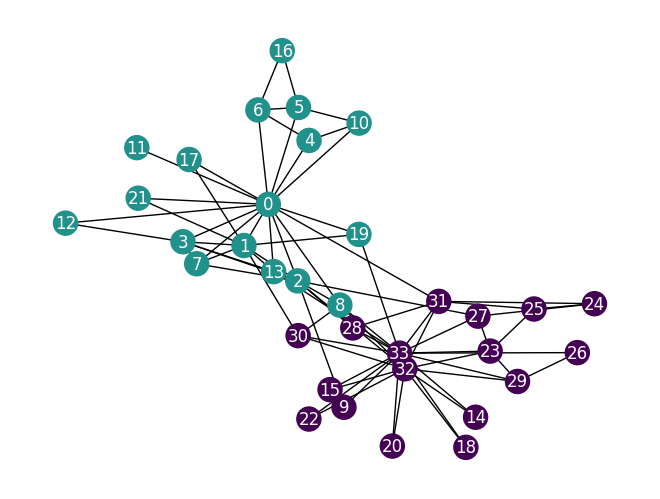

In [6]:
# Extract the attribute 'club' from the nodes
clubs = [club for _, club in G.nodes(data='club')]

# Enumerate the values
unique_clubs = list(set(clubs))
club_colors = {club: i for i, club in enumerate(unique_clubs)}

# Create a color map using a rainbow palette
color_map = [plt.cm.viridis(club_colors[club] / len(unique_clubs)) for club in clubs]

# Visualize the network with node colors
nx.draw(G, pos, node_color=color_map, with_labels=True, font_color='white')
plt.show()

In [7]:
# Extract communities from the node attribute 'club'
clubs = {club for _, club in G.nodes(data="club")}
communities = {club: [] for club in clubs}
for node, club in G.nodes(data="club"):
    communities[club].append(node)

print("Communities:", communities)

# Calculate the modularity of the network
modularity = nx.algorithms.community.modularity(G, communities.values())
print("Modularity:", modularity)

Communities: {'Officer': [9, 14, 15, 18, 20, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33], 'Mr. Hi': [0, 1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12, 13, 16, 17, 19, 21]}
Modularity: 0.39143756676224206


c:\Users\YuxinLi\anaconda3\envs\ST5225\Lib\site-packages\networkx\drawing\nx_pylab.py:1438: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


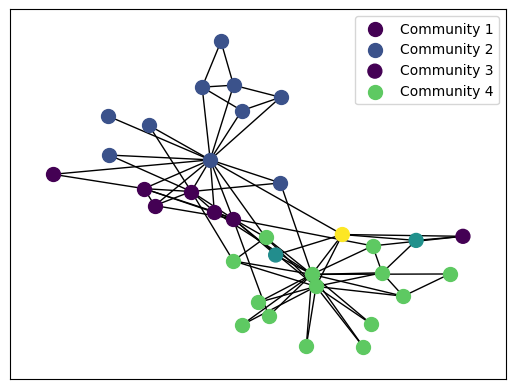

Modularity: 0.4266224396094526


In [8]:
# Use the Louvain method to detect communities in the network
partition = nx.community.louvain_communities(G, seed=42)

# Visualize the communities
colors = [plt.cm.viridis(i / len(partition)) for i in range(len(partition))]
pos = nx.spring_layout(G, seed=42)
for i, community in enumerate(partition):
  nx.draw_networkx_nodes(G, pos, nodelist=list(community), node_color=colors[i], label=f'Community {i+1}', node_size=100)
nx.draw_networkx_edges(G, pos)
plt.legend()
plt.show()

# Calculate the modularity of the partition
modularity = nx.algorithms.community.modularity(G, partition)
print("Modularity:", modularity)

c:\Users\YuxinLi\anaconda3\envs\ST5225\Lib\site-packages\networkx\drawing\nx_pylab.py:1438: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


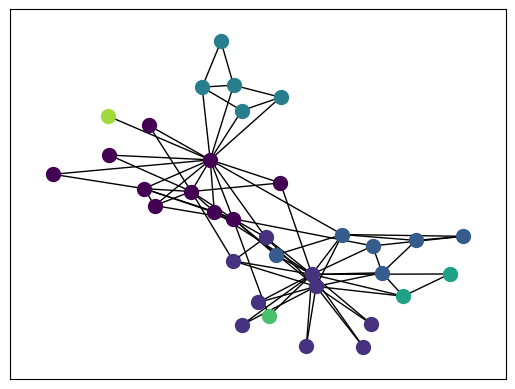

In [10]:
import igraph as ig
import leidenalg as la

# Create a simple graph
g = ig.Graph.Famous("Zachary")  # Zachary's Karate Club graph

# Detect communities using the Leiden algorithm
partition = la.find_partition(g, la.CPMVertexPartition, resolution_parameter=0.2)

# Visualize the communities
colors = [plt.cm.viridis(i / len(partition)) for i in range(len(partition))]
pos = nx.spring_layout(G, seed=42)
for i, community in enumerate(partition):
  nx.draw_networkx_nodes(G, pos, nodelist=list(community), node_color=colors[i], node_size=100)
nx.draw_networkx_edges(G, pos)
plt.show()

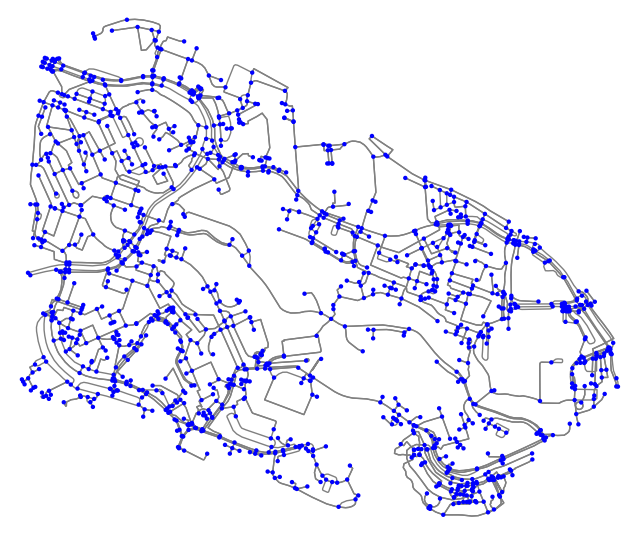

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [11]:
import osmnx as ox # pip install folium matplotlib mapclassify

G = ox.graph_from_place('National University of Singapore', network_type='all')

ox.plot_graph(G, node_size=10, node_color='blue', edge_color='gray', bgcolor='white')

# # If you want to have an interactive map, you can use the following code
# mp = ox.graph_to_gdfs(G, nodes=False).explore()
# mp

In [12]:
import folium

def plotClusters(G, partition, mp=None):
  """
  Parameters:
  - G: NetworkX graph object.
    The graph object containing the nodes and edges.
  - partition: dict or list
    If a list:
      - It can be of the same length as the number of nodes in the graph,
        representing the cluster assignment for each node.
      - It can be a list of communities, where each community is a list of nodes.
    If a dict, it should map nodes to cluster IDs.
  - mp: folium.Map (optional)
    A folium map object to add the clusters to. If None, a new map centered on the 
    National University of Singapore will be created.
  """
  # This part of the code ensures that the partision is a dictornary of communities, 
  # enumerated starting from 0
  if type(partition) == np.ndarray:
    partition = list(partition)
  if type(partition) == list:
    if len(partition) == len(G.nodes()):
      nodes = list(G.nodes())
      new_partition = dict()
      for i in range(len(partition)):
        if partition[i] not in new_partition.keys():
          new_partition[partition[i]] = [nodes[i]]
        else:
          new_partition[partition[i]].append(nodes[i])
      partition = dict(enumerate(new_partition.values()))
    else:
      partition = dict(enumerate(partition))
  elif type(partition) == 'dict':
      partition = dict(enumerate(partition.values()))
  
  
  # This generates the map
  df = ox.geocoder.geocode_to_gdf('National University of Singapore')
  lat = df['lat']
  lon = df['lon']
  if mp is None:
    mp = folium.Map((lat, lon), zoom_start = 16)

  colors_palette = ['red', 'blue', 'green', 'purple', 'orange', 'pink', 'darkred', 'lightred', 'beige', 'darkblue', 'darkgreen', 'cadetblue', 'darkpurple', 'white', 'lightblue', 'lightgreen', 'gray', 'black', 'lightgray']
  colors = [colors_palette[i % len(colors_palette)] for i in range(len(partition))]

  # Go through each community and add the nodes to the map
  for col, community in partition.items():
    for node in community:
      folium.CircleMarker(
          location=[G.nodes()[node]['y'], G.nodes()[node]['x']],
          radius=3,
          color=colors[col],
          stroke=False,
          fill=True,
          fill_opacity=1,
          opacity=1,
      ).add_to(mp)
  return mp

In [13]:
G_simple = nx.Graph()
G_simple.add_nodes_from(G.nodes(data=True))
nodes = list(G.nodes())
for i in range(len(G.nodes)):
  for j in range(i + 1, len(G.nodes)):
      u, v = nodes[i], nodes[j]
      if G.has_edge(u, v):
          min_length = min([d['length'] for i, j, d in G.edges(data=True) if (i, j) in [(u, v), (v, u)]])
          G_simple.add_edge(u, v, length=min_length)
# Let's extract the largest connected component
G_simple = G_simple.subgraph(max(nx.connected_components(G_simple), key=len)).copy()

In [16]:
partition = nx.community.louvain_communities(G_simple, seed=42)
print(f"Number of communities: {len(partition)}")
plotClusters(G_simple, partition, ox.graph_to_gdfs(G, nodes=False).explore())

Number of communities: 28


In [17]:
partition = nx.community.louvain_communities(G_simple, weight="length", seed=42, resolution=0.01)
print(f"Number of communities: {len(partition)}")
plotClusters(G_simple, partition, ox.graph_to_gdfs(G, nodes=False).explore())

Number of communities: 4


In [18]:
L = nx.laplacian_matrix(G_simple, weight="length").astype(float).toarray()
eigvals, eigvecs = np.linalg.eigh(L)
eigvecs = eigvecs[:, :5]
kmeans = KMeans(n_clusters=5)
labels = kmeans.fit_predict(eigvecs)
plotClusters(G_simple, labels, ox.graph_to_gdfs(G, nodes=False).explore())

In [20]:
L = nx.normalized_laplacian_matrix(G_simple, weight='length').astype(float).toarray()
eigvals, eigvecs = np.linalg.eigh(L)
eigvecs = eigvecs[:, :5]
kmeans = KMeans(n_clusters=5)
labels = kmeans.fit_predict(eigvecs)
plotClusters(G_simple, labels, ox.graph_to_gdfs(G, nodes=False).explore())

In [21]:
L = nx.normalized_laplacian_matrix(G_simple).astype(float).toarray()
eigvals, eigvecs = np.linalg.eigh(L)
eigvecs = eigvecs[:, :5]
kmeans = KMeans(n_clusters=5)
labels = kmeans.fit_predict(eigvecs)
plotClusters(G_simple, labels, ox.graph_to_gdfs(G, nodes=False).explore())

In [22]:
from sklearn.cluster import SpectralClustering

# Perform spectral clustering
spectral = SpectralClustering(n_clusters=5, affinity='precomputed', random_state=42)
adjacency_matrix = nx.adjacency_matrix(G_simple, weight="length").toarray()
labels = spectral.fit_predict(adjacency_matrix)
print(f"Number of communities: {max(labels)+1}")
plotClusters(G_simple, labels, ox.graph_to_gdfs(G, nodes=False).explore())

Number of communities: 5


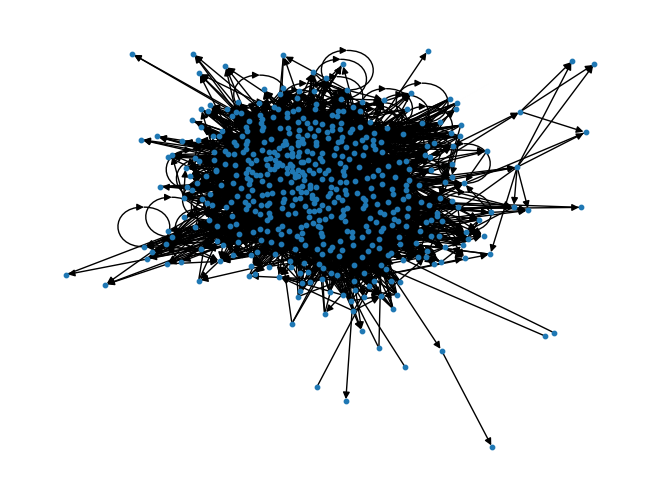

In [23]:
import pandas as pd

# Read the 'Taxa Lists' sheet
taxa_df = pd.read_excel('C:\\Users\\YuxinLi\\Downloads\\Sanak_Nearshore_Marine_Food_Web.xlsx', sheet_name='Taxa Lists')

# Read the 'Trophic Links' sheet
links_df = pd.read_excel('C:\\Users\\YuxinLi\\Downloads\\Sanak_Nearshore_Marine_Food_Web.xlsx', sheet_name='Trophic Links')

# Create an empty network
G = nx.DiGraph()

# Add nodes to the network
for index, row in taxa_df.iterrows():
  node_id = row['ID']
  node_name = row['Name']
  node_phylum = row['Phylum']
  G.add_node(node_id, name=node_name, phylum=row['Phylum'])

# Add edges to the network
for index, row in links_df.iterrows():
  consumer_id = row['Consumer']
  resource_id = row['Resource']
  G.add_edge(resource_id, consumer_id)

# Print the network summary
# Visualize the network using spring layout
pos = nx.spring_layout(G)
nx.draw(G, pos, node_size=10)
plt.show()

In [24]:
# Convert the network to adjacency matrix
adj_matrix = nx.adjacency_matrix(G).toarray()

# Perform spectral clustering
spectral = SpectralClustering(n_clusters=5, affinity='precomputed', random_state=0)
labels = spectral.fit_predict(adj_matrix)

# Store the cluster labels as node attributes
for node_id, label in zip(G.nodes(), labels):
  G.nodes[node_id]['cluster'] = label

c:\Users\YuxinLi\anaconda3\envs\ST5225\Lib\site-packages\sklearn\manifold\_spectral_embedding.py:309: UserWarning: Array is not symmetric, and will be converted to symmetric by average with its transpose.
  adjacency = check_symmetric(adjacency)


In [25]:
# Perform modularity clustering
communities = nx.community.louvain_communities(G, resolution=2)

for i, community in zip(range(len(communities)), communities):
  print(i, len(community), community)
  for node in community:
    G.nodes[node]['cluster'] = i

0 29 {320, 191, 194, 322, 325, 326, 467, 471, 472, 27, 29, 221, 32, 36, 38, 39, 296, 301, 46, 429, 48, 366, 307, 373, 312, 313, 317, 318, 319}
1 9 {224, 162, 195, 71, 264, 496, 498, 86, 189}
2 19 {397, 148, 342, 344, 152, 92, 222, 223, 161, 356, 101, 230, 103, 104, 295, 123, 122, 443, 445}
3 21 {131, 327, 267, 141, 147, 149, 150, 151, 346, 91, 347, 95, 352, 96, 232, 362, 364, 367, 254, 121, 190}
4 37 {256, 385, 386, 388, 389, 154, 155, 26, 159, 168, 172, 176, 177, 182, 183, 56, 61, 63, 193, 73, 85, 87, 89, 226, 227, 229, 105, 238, 379, 125, 246, 247, 249, 250, 251, 252, 253}
5 29 {130, 331, 143, 144, 25, 411, 284, 348, 412, 31, 416, 417, 415, 413, 292, 30, 424, 41, 425, 426, 428, 365, 45, 430, 427, 436, 437, 442, 382}
6 54 {1, 2, 3, 4, 5, 6, 513, 22, 24, 285, 294, 339, 43, 432, 50, 51, 310, 440, 314, 316, 198, 200, 201, 202, 203, 204, 205, 333, 335, 208, 206, 207, 334, 337, 338, 214, 340, 341, 213, 210, 211, 215, 219, 216, 217, 220, 355, 239, 241, 242, 243, 244, 376, 378}
7 42 {129, 15

In [26]:
G_agg = nx.DiGraph()
cluster_ids = set([cluster for v, cluster in G.nodes("cluster")])

# Iterate over each cluster
for cluster_id in cluster_ids:
  # Get the nodes in the cluster
  cluster_nodes = [node for node in G.nodes() if G.nodes[node]['cluster'] == cluster_id]
  
  # Calculate the size of the cluster
  cluster_size = len(cluster_nodes)
  
  # Add the cluster node to the new graph
  G_agg.add_node(cluster_id, size=cluster_size)
  
  # Calculate the number of edges within the cluster
  cluster_edges = sum(1 for edge in G.edges() if edge[0] in cluster_nodes and edge[1] in cluster_nodes)

  # Add the loop edge representing the number of edges within the cluster
  G_agg.add_edge(cluster_id, cluster_id, weight=cluster_edges)

  # Add the edges between clusters
  for other_cluster_id in cluster_ids - {cluster_id}:
    other_cluster_nodes = [node for node in G.nodes() if G.nodes[node]['cluster'] == other_cluster_id]
    inter_cluster_edges = sum(1 for edge in G.edges() if edge[0] in cluster_nodes and edge[1] in other_cluster_nodes)
    if inter_cluster_edges > 0:
      G_agg.add_edge(cluster_id, other_cluster_id, weight=inter_cluster_edges)

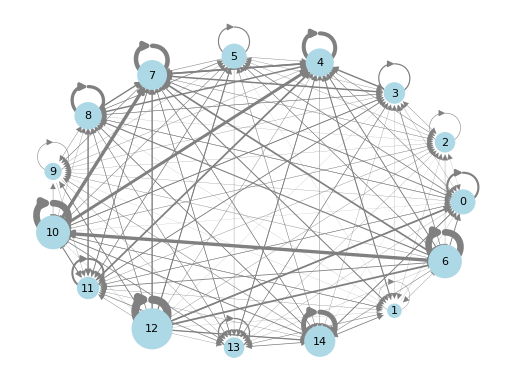

In [27]:
# Visualize the new network using circular layout
pos_agg = nx.circular_layout(G_agg)

# Get the node sizes
node_sizes = [G_agg.nodes[node]['size'] * 10 for node in G_agg.nodes()]

# Get the edge weights
edge_weights = [G_agg.edges[edge]['weight']/70 for edge in G_agg.edges()]

# Draw the nodes
nx.draw_networkx_nodes(G_agg, pos_agg, node_size=node_sizes, node_color='lightblue')

# Draw the edges
nx.draw_networkx_edges(G_agg, pos_agg, width=edge_weights, edge_color='gray')

# Draw the labels
nx.draw_networkx_labels(G_agg, pos_agg, font_size=8)

# Remove the axis
plt.axis('off')

# Show the plot
plt.show()

In [28]:
# Construct a cross-tabulation of the cluster labels and the phylum of the nodes
cross_tab = pd.crosstab(index=[G.nodes[node]['phylum'] for node in G.nodes()], 
            columns=[f"C{G.nodes[node]['cluster']:02.0f}" for node in G.nodes()])

# Print the cross-tabulation
cross_tab

col_0,C00,C01,C02,C03,C04,C05,C06,C07,C08,C09,C10,C11,C12,C13,C14
row_0,,,,,,,,,,,,,,,
Acanthocephala,0,0,0,0,2,0,0,0,0,0,0,0,0,0,0
Annelida,0,0,0,2,0,1,1,0,19,0,0,2,0,0,1
Arthropoda,2,1,5,6,0,6,10,4,0,1,11,5,7,2,2
Ascomycota,0,0,0,0,0,0,0,0,0,0,0,0,2,0,0
Bacillariophyta,0,0,0,0,0,0,13,0,0,0,0,0,1,0,0
Bacteria,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
Brachiopoda,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
Chaetognatha,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
Chlorophyta,0,0,0,0,0,0,0,0,0,2,0,0,3,0,0


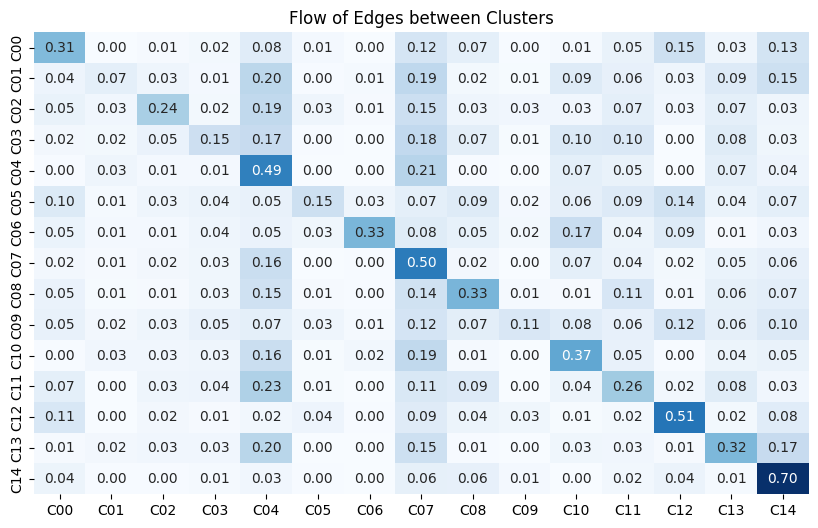

In [29]:
import seaborn as sns

# Get the edge weights between clusters
edge_weights = np.zeros((len(cluster_ids), len(cluster_ids)))
for edge in G_agg.edges():
  source_cluster = edge[0]
  target_cluster = edge[1]
  weight = G_agg.edges[edge]['weight']
  edge_weights[source_cluster][target_cluster] = weight

# Normalize the edge weights
edge_weights_normalized = edge_weights / np.sum(edge_weights, axis=1, keepdims=True)

# Create the Sanky diagram
fig, ax = plt.subplots(figsize=(10, 6))
sns.heatmap(edge_weights_normalized, cmap='Blues', annot=True, fmt='.2f', cbar=False, ax=ax)

# Set the axis labels
ax.set_xticklabels([f"C{i:02.0f}" for i in cluster_ids])
ax.set_yticklabels([f"C{i:02.0f}" for i in cluster_ids])

# Set the title
ax.set_title("Flow of Edges between Clusters")

# Show the plot
plt.show()

In [30]:
idx = [v for v, name in G.nodes("name") if name == "Homo sapiens"]
G.nodes()[idx[0]]

{'name': 'Homo sapiens', 'phylum': 'Chordata', 'cluster': 7}

In [31]:
import pandas as pd

# Load CSV files (assumes they are in the same directory as this notebook)
aa_edges = pd.read_csv("C:\\Users\\YuxinLi\\Downloads\\AA_edges.csv")
wn_edges = pd.read_csv("C:\\Users\\YuxinLi\\Downloads\\WN_edges.csv")
airport_codes = pd.read_csv("C:\\Users\\YuxinLi\\Downloads\\airport-codes.csv")

display(aa_edges.head())
display(wn_edges.head())
display(airport_codes.head())

,ORIGIN,DEST,weight
0,LAX,DFW,2489
1,DFW,LAX,2486
2,DCA,BOS,2325
3,BOS,DCA,2321
4,LGA,ORD,2315


,ORIGIN,DEST,weight
0,HOU,DAL,3379
1,DAL,HOU,3374
2,SAN,SJC,2435
3,SJC,SAN,2430
4,SMF,SAN,2332


,ident,type,name,elevation_ft,continent,iso_country,iso_region,municipality,icao_code,iata_code,gps_code,local_code,coordinates
0,00A,heliport,Total RF Heliport,11.0,NaN,US,US-PA,Bensalem,NaN,NaN,K00A,00A,"40.070985, -74.933689"
1,00AA,small_airport,Aero B Ranch Airport,3435.0,NaN,US,US-KS,Leoti,NaN,NaN,00AA,00AA,"38.704022, -101.473911"
2,00AK,small_airport,Lowell Field,450.0,NaN,US,US-AK,Anchor Point,NaN,NaN,00AK,00AK,"59.947733, -151.692524"
3,00AL,small_airport,Epps Airpark,820.0,NaN,US,US-AL,Harvest,NaN,NaN,00AL,00AL,"34.86479949951172, -86.77030181884766"
4,00AN,small_airport,Katmai Lodge Airport,80.0,NaN,US,US-AK,King Salmon,NaN,NaN,00AN,00AN,"59.093287, -156.456699"


In [32]:
import math

# Build AA graph with custom weights (rvu/dist^2)
G_AA = nx.Graph()

# Prepare coordinate lookup (prefer iata_code else ident)
airport_codes['coord_tuple'] = airport_codes['coordinates'].str.split(',').apply(lambda x: (float(x[0]), float(x[1])) if isinstance(x, list) and len(x)==2 else (None, None))
code_to_coord = {}
for _, row in airport_codes.iterrows():
    key = row.get('iata_code') if isinstance(row.get('iata_code'), str) and row.get('iata_code') != '' else row.get('ident')
    if key not in code_to_coord:
        code_to_coord[key] = row['coord_tuple']

# Count directional flights for AA using provided weight column (already aggregated)
aa_counts = {}
for _, r in aa_edges.iterrows():
    o = r['ORIGIN']
    d = r['DEST']
    f = r['weight']
    aa_counts[(o,d)] = aa_counts.get((o,d), 0) + f

# Haversine distance
def distance(c1, c2):
    if c1[0] is None or c2[0] is None:
        return None
    lat1, lon1 = math.radians(c1[0]), math.radians(c1[1])
    lat2, lon2 = math.radians(c2[0]), math.radians(c2[1])
    dlat = lat2 - lat1
    dlon = lon2 - lon1
    a = math.sin(dlat/2)**2 + math.cos(lat1)*math.cos(lat2)*math.sin(dlon/2)**2
    c = 2*math.atan2(math.sqrt(a), math.sqrt(1-a))
    R = 6371.0
    return R * c

# Build undirected edges with attributes rvu and distance
for (u,v), f_uv in aa_counts.items():
    if (v,u) in aa_counts and u < v:
        f_vu = aa_counts[(v,u)]
        rvu = min(f_uv,f_vu)/max(f_uv,f_vu)
        cu = code_to_coord.get(u)
        cv = code_to_coord.get(v)
        if cu and cv:
            dist = distance(cu, cv)
            if dist and dist > 0:
                w = rvu / (dist**2)
                if w > 0:
                    G_AA.add_edge(u, v, weight=w, rvu=rvu, distance=dist)

# Build WN graph with custom weights (rvu/dist^2)
G_WN = nx.Graph()

wn_counts = {}
for _, r in wn_edges.iterrows():
    o = r['ORIGIN']
    d = r['DEST']
    f = r['weight']
    wn_counts[(o,d)] = wn_counts.get((o,d), 0) + f

for (u,v), f_uv in wn_counts.items():
    if (v,u) in wn_counts and u < v:
        f_vu = wn_counts[(v,u)]
        rvu = min(f_uv,f_vu)/max(f_uv,f_vu)
        cu = code_to_coord.get(u)
        cv = code_to_coord.get(v)
        if cu and cv:
            dist = distance(cu, cv)
            if dist and dist > 0:
                w = rvu / (dist**2)
                if w > 0:
                    G_WN.add_edge(u, v, weight=w, rvu=rvu, distance=dist)

# Show sample of edges with attributes for both graphs

def edge_sample(G, n=10):
    edges = [(u, v, d.get('weight'), d.get('rvu'), d.get('distance')) for u, v, d in G.edges(data=True)]
    edges.sort(key=lambda x: x[2], reverse=True)
    return pd.DataFrame(edges[:n], columns=['u', 'v', 'weight', 'rvu', 'distance'])

print('AA sample edges:')
display(edge_sample(G_AA, 10))
print('WN sample edges:')
display(edge_sample(G_WN, 10))

AA sample edges:


,u,v,weight,rvu,distance
0,CLT,GSO,0.000056,1.000000,133.847949
1,LGA,PHL,0.000042,0.995227,153.594589
2,PHX,TUS,0.000032,1.000000,177.537500
3,DCA,PHL,0.000025,0.917738,191.605100
4,CLT,RDU,0.000023,1.000000,208.511973
5,CLT,MYR,0.000016,0.996364,251.462901
6,CLT,CHS,0.000014,1.000000,270.550879
7,DFW,OKC,0.000013,0.999188,282.353131
8,CLT,TYS,0.000012,1.000000,283.994902
9,ORD,IND,0.000012,1.000000,285.595189


WN sample edges:


,u,v,weight,rvu,distance
0,HNL,OGG,0.000038,1.000000,161.841848
1,MDW,GRR,0.000021,1.000000,220.007021
2,HOU,AUS,0.000017,0.976987,237.728387
3,ATL,GSP,0.000016,1.000000,246.591776
4,BWI,ORF,0.000015,0.989319,256.811762
5,MDW,IND,0.000015,0.996610,260.751158
6,HNL,KOA,0.000014,0.995000,263.066667
7,OAK,RNO,0.000012,1.000000,290.781574
8,DAL,OKC,0.000012,1.000000,291.349960
9,MCO,FLL,0.000012,0.943820,285.901396


In [33]:
# Louvain community detection and summary for AA and WN
from networkx.algorithms.community import louvain_communities, modularity
from collections import Counter

# Detect communities (returns list of sets)
AA_comms = louvain_communities(G_AA, weight='weight')
WN_comms = louvain_communities(G_WN, weight='weight')

AA_mod = modularity(G_AA, AA_comms, weight='weight')
WN_mod = modularity(G_WN, WN_comms, weight='weight')

# Helper to summarize sizes
def summarize(comms):
    sizes = sorted([len(c) for c in comms], reverse=True)
    return sizes, Counter(sizes)

AA_sizes, _ = summarize(AA_comms)
WN_sizes, _ = summarize(WN_comms)

print('American Airlines (AA)')
print(' Communities:', len(AA_comms))
print(' Modularity:', round(AA_mod, 4))
print(' Largest community sizes:', AA_sizes[:10])
print()
print('Southwest Airlines (WN)')
print(' Communities:', len(WN_comms))
print(' Modularity:', round(WN_mod, 4))
print(' Largest community sizes:', WN_sizes[:10])

American Airlines (AA)
 Communities: 6
 Modularity: 0.5876
 Largest community sizes: [30, 28, 25, 12, 12, 6]

Southwest Airlines (WN)
 Communities: 5
 Modularity: 0.5348
 Largest community sizes: [32, 22, 16, 15, 3]


In [34]:
# Identify most central (highest weighted degree) airport per community for each network

def top_strength_per_community(G, comms):
    rows = []
    for idx, comm in enumerate(comms):
        sub = G.subgraph(comm)
        # weighted degree (strength) within community only
        strengths = {n: sum(d.get('weight', 1) for _, _, d in sub.edges(n, data=True)) for n in sub.nodes()}
        top_node, top_strength = max(strengths.items(), key=lambda x: x[1]) if strengths else (None, 0)
        rows.append({
            'community_id': idx,
            'community_size': len(comm),
            'top_airport': top_node,
            'top_strength': top_strength
        })
    return pd.DataFrame(rows).sort_values('community_size', ascending=False).reset_index(drop=True)

AA_central = top_strength_per_community(G_AA, AA_comms)
WN_central = top_strength_per_community(G_WN, WN_comms)

print('AA community top airports:')
display(AA_central.head(20))
print('WN community top airports:')
display(WN_central.head(20))

AA community top airports:


,community_id,community_size,top_airport,top_strength
0,0,30,DFW,0.000086
1,4,28,PHX,0.000073
2,3,25,CLT,0.000184
3,1,12,ORD,0.000046
4,2,12,PHL,0.000109
5,5,6,MIA,0.000021


WN community top airports:


,community_id,community_size,top_airport,top_strength
0,2,32,BWI,0.000083
1,1,22,LAS,0.000076
2,3,16,MDW,0.000073
3,0,15,DAL,0.000066
4,4,3,HNL,0.000053


C:\Users\YuxinLi\AppData\Local\Temp\ipykernel_14632\3088719724.py:31: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  palette = get_cmap('tab20')


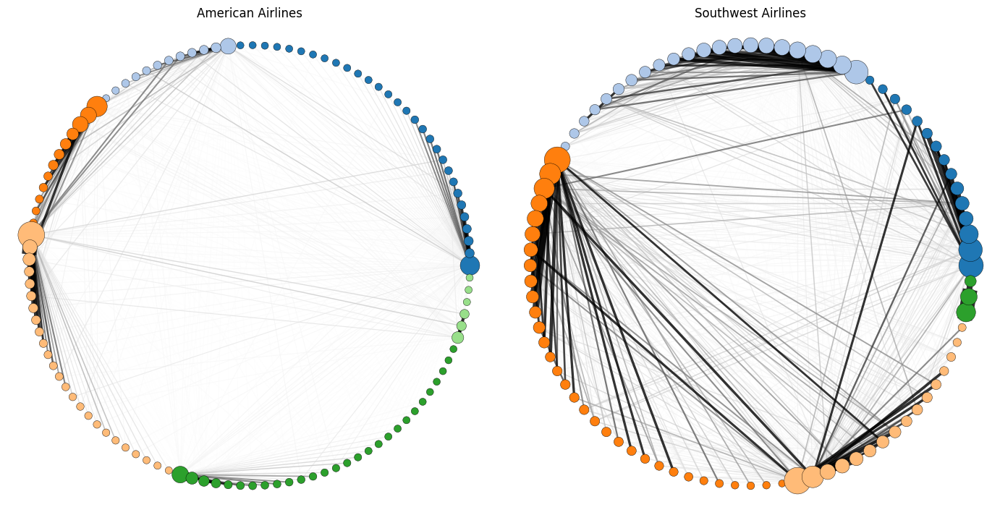

In [35]:
# 2-panel circular layout visualization for AA and WN networks
import matplotlib.pyplot as plt
import numpy as np

# Build node -> community index maps
AA_comm_index = {}
for i, comm in enumerate(AA_comms):
    for n in comm:
        AA_comm_index[n] = i
WN_comm_index = {}
for i, comm in enumerate(WN_comms):
    for n in comm:
        WN_comm_index[n] = i

# Helper to order nodes: by community id then by weighted degree (descending)
def ordered_nodes(G, comm_index):
    degs = dict(G.degree(weight='weight'))
    return sorted(G.nodes(), key=lambda n: (comm_index.get(n, 10**9), -degs.get(n, 0), n))

# Compute circular positions given ordered nodes
def circular_positions(nodes):
    pos = {}
    n = len(nodes)
    for k, node in enumerate(nodes):
        theta = 2 * np.pi * k / n
        pos[node] = (np.cos(theta), np.sin(theta))
    return pos

# Color palette per community (simple cycling)
from matplotlib.cm import get_cmap
palette = get_cmap('tab20')

def community_colors(nodes, comm_index):
    colors = []
    for n in nodes:
        c = comm_index.get(n, -1)
        if c < 0:
            colors.append('#cccccc')
        else:
            colors.append(palette(c % palette.N))
    return colors

# Node sizes scaled by weighted degree
def node_sizes(G, nodes):
    degs = dict(G.degree(weight='weight'))
    vals = [degs[n] for n in nodes]
    mn, mx = min(vals), max(vals)
    if mx == mn:
        return [300 for _ in vals]
    return [50 + 650 * (v - mn) / (mx - mn) for v in vals]

# Draw a single graph on provided axis
def draw_graph(ax, G, comms, comm_index, title):
    nodes = ordered_nodes(G, comm_index)
    pos = circular_positions(nodes)
    n_colors = community_colors(nodes, comm_index)
    n_sizes = node_sizes(G, nodes)

    # Sort edges by weight ascending so heavy edges draw last
    edges = [(u, v, d.get('weight', 0)) for u, v, d in G.edges(data=True)]
    if not edges:
        ax.set_title(title + ' (no edges)')
        ax.axis('off')
        return
    w_vals = [w for _,_,w in edges]
    w_min, w_max = min(w_vals), max(w_vals)

    edges_sorted = sorted(edges, key=lambda x: x[2])
    for u, v, w in edges_sorted:
        if w_max == w_min:
            t = 0.5
        else:
            t = 10 * (w - w_min) / (w_max - w_min)
        col = plt.cm.Greys(t)  # white (low) -> black (high)
        x_vals = [pos[u][0], pos[v][0]]
        y_vals = [pos[u][1], pos[v][1]]
        ax.plot(x_vals, y_vals, color=col, linewidth=0.6 + 1.4 * t, alpha=0.8)

    # Draw nodes
    xs = [pos[n][0] for n in nodes]
    ys = [pos[n][1] for n in nodes]
    ax.scatter(xs, ys, c=n_colors, s=n_sizes, edgecolors='k', linewidths=0.3, zorder=10)

    ax.set_title(title)
    ax.set_aspect('equal')
    ax.axis('off')

fig, axes = plt.subplots(1, 2, figsize=(14, 7))

draw_graph(axes[0], G_AA, AA_comms, AA_comm_index, 'American Airlines')
draw_graph(axes[1], G_WN, WN_comms, WN_comm_index, 'Southwest Airlines')

plt.tight_layout()
plt.show()

In [36]:
import pandas as pd
import networkx as nx

# Load interaction matrix (rows and columns are species names)
# Assumes the CSV file is in the same directory as this notebook.
filename = "C:\\Users\\YuxinLi\\Downloads\\M_PL_001.csv"
df = pd.read_csv(filename, index_col=0)

# Create bipartite graph: one part = row species, other part = column species
B = nx.Graph()
B.add_nodes_from(df.index, bipartite=0)
B.add_nodes_from(df.columns, bipartite=1)

for row_name, row in df.iterrows():
    for col_name, value in row.items():
        if value != 0:  # add edge only for non-zero interactions
            B.add_edge(row_name, col_name, weight=value)

print("DataFrame shape:", df.shape)
print("Number of nodes:", B.number_of_nodes())
print("Number of edges (non-zero interactions):", B.number_of_edges())

# Preview a few edges
for edge in list(B.edges(data=True))[:10]:
    print(edge)

# Objects available for later use: df (DataFrame), B (Graph)

DataFrame shape: (84, 101)
Number of nodes: 185
Number of edges (non-zero interactions): 361
('Acaena pinn', 'Scaeva melanostoma', {'weight': 1})
('Adesmia aconcaguensis', 'Chilimelissa sp1 M_PL_001', {'weight': 1})
('Adesmia aconcaguensis', 'Diptera sp2 M_PL_001', {'weight': 1})
('Adesmia aconcaguensis', 'Scaeva melanostoma', {'weight': 1})
('Adesmia aconcaguensis', 'Villa semifuscata', {'weight': 1})
('Adesmia aconcaguensis', 'Villa sp1 M_PL_001', {'weight': 1})
('Adesmia aconcaguensis', 'Xanthocolletes sicheli', {'weight': 1})
('Adesmia brachy', 'Anthidium decapsilum', {'weight': 1})
('Adesmia brachy', 'Centris cineraria', {'weight': 1})
('Adesmia brachy', 'Megachile semirufa', {'weight': 1})


In [37]:
# Community detection first (before layout)
from networkx.algorithms import bipartite
from networkx.algorithms.community import louvain_communities

# Identify the two node sets
plants = [n for n, d in B.nodes(data=True) if d.get('bipartite') == 0]
pollinators = [n for n, d in B.nodes(data=True) if d.get('bipartite') == 1]

# Louvain communities on full bipartite graph
communities = louvain_communities(B, weight='weight', seed=42)
node_to_comm = {}
for idx, comm in enumerate(communities):
    for node in comm:
        node_to_comm[node] = idx

print(f"Detected {len(communities)} communities")
print("Community sizes:", [len(c) for c in communities])

Detected 11 communities
Community sizes: [17, 2, 21, 22, 11, 3, 15, 21, 3, 30, 40]


Layout generated with community ordering and increased gaps.
Parameters -> node_spacing: 1.0, community_gap: 4.0


C:\Users\YuxinLi\AppData\Local\Temp\ipykernel_14632\728898643.py:45: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = cm.get_cmap('tab20', len(communities))


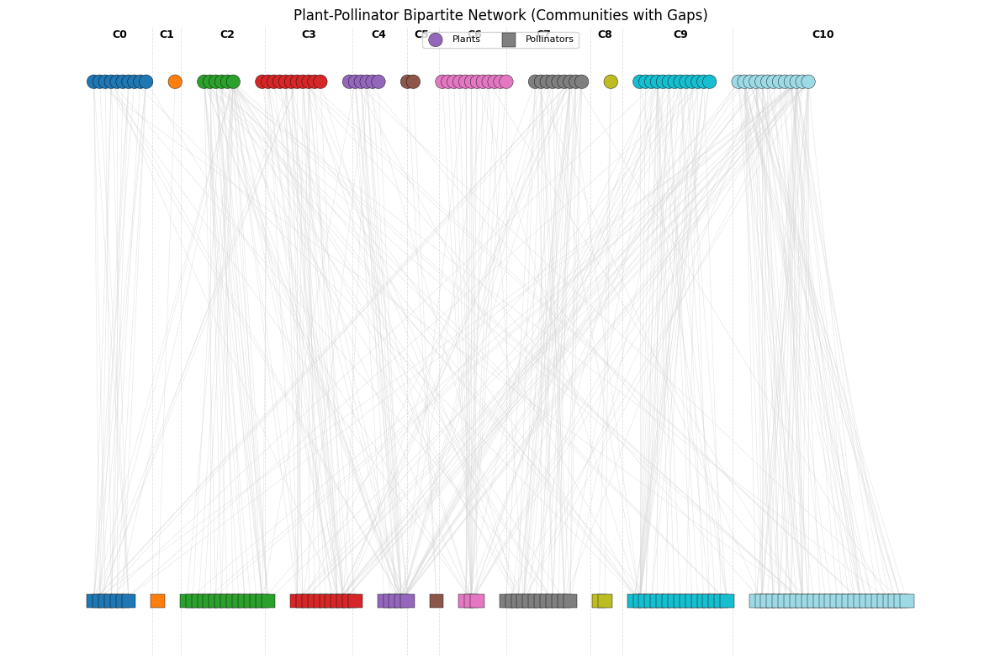

In [38]:
# Community-ordered bipartite layout (with adjustable gaps)
# Parameters
node_spacing = 1.0      # horizontal spacing between nodes inside a community
community_gap = 4.0     # extra horizontal gap inserted when community changes (increased for more space)

# Order plants and pollinators separately by community index
plants_by_comm = sorted(plants, key=lambda n: node_to_comm[n])
pollinators_by_comm = sorted(pollinators, key=lambda n: node_to_comm[n])

plant_positions = {}
pollinator_positions = {}

x_cursor = 0.0
current_comm = None
for n in plants_by_comm:
    c = node_to_comm[n]
    if current_comm is None:
        current_comm = c
    elif c != current_comm:
        x_cursor += community_gap  # add gap before starting next community
        current_comm = c
    plant_positions[n] = (x_cursor, 1.0)
    x_cursor += node_spacing

x_cursor = 0.0
current_comm = None
for n in pollinators_by_comm:
    c = node_to_comm[n]
    if current_comm is None:
        current_comm = c
    elif c != current_comm:
        x_cursor += community_gap
        current_comm = c
    pollinator_positions[n] = (x_cursor, 0.0)
    x_cursor += node_spacing

pos = {**plant_positions, **pollinator_positions}
print("Layout generated with community ordering and increased gaps.")
print(f"Parameters -> node_spacing: {node_spacing}, community_gap: {community_gap}")

# Visualize bipartite graph colored by community (community-ordered layout with gaps)
import matplotlib.pyplot as plt
import matplotlib.cm as cm

colors = cm.get_cmap('tab20', len(communities))
plt.figure(figsize=(12, 8))

plant_nodes = [n for n in B.nodes if B.nodes[n]['bipartite'] == 0]
pollinator_nodes = [n for n in B.nodes if B.nodes[n]['bipartite'] == 1]

nx.draw_networkx_edges(B, pos, width=0.5, edge_color='lightgray', alpha=0.5)

plant_colors = [colors(node_to_comm[n] % colors.N) for n in plant_nodes]
pollinator_colors = [colors(node_to_comm[n] % colors.N) for n in pollinator_nodes]

nx.draw_networkx_nodes(B, pos, nodelist=plant_nodes, node_color=plant_colors, node_shape='o', label='Plants', node_size=140, edgecolors='k', linewidths=0.3)
nx.draw_networkx_nodes(B, pos, nodelist=pollinator_nodes, node_color=pollinator_colors, node_shape='s', label='Pollinators', node_size=140, edgecolors='k', linewidths=0.3)

# Collect x positions per community (using any node representative)
comm_x_values = {}
for n in plant_nodes + pollinator_nodes:
    c = node_to_comm[n]
    x_val = pos[n][0]
    comm_x_values.setdefault(c, []).append(x_val)

# Determine x span per community
comm_spans = {c: (min(xs), max(xs)) for c, xs in comm_x_values.items()}

# Draw separators at midpoints between adjacent communities (sorted by starting x)
sorted_comms = sorted(comm_spans.items(), key=lambda kv: kv[1][0])
for i in range(len(sorted_comms) - 1):
    _, (start_a, end_a) = sorted_comms[i]
    _, (start_b, end_b) = sorted_comms[i + 1]
    separator_x = (end_a + start_b) / 2
    plt.axvline(separator_x, color='lightgray', linestyle='--', linewidth=0.6, alpha=0.7, zorder=0)

# Annotate community labels slightly above the plant row
for c, (x_min, x_max) in sorted_comms:
    mid_x = (x_min + x_max) / 2
    plt.text(mid_x, 1.08, f'C{c}', ha='center', va='bottom', fontsize=9, fontweight='bold')

plt.title('Plant-Pollinator Bipartite Network (Communities with Gaps)')
plt.axis('off')
plt.legend(scatterpoints=1, fontsize=8, loc='upper center', ncol=2)
plt.tight_layout()
plt.show()

In [39]:
# Compute modularity of the Louvain partition
from networkx.algorithms.community.quality import modularity
modularity_value = modularity(B, communities, weight='weight')
print(f"Modularity of Louvain partition: {modularity_value:.4f}")

Modularity of Louvain partition: 0.4978


In [40]:
# Sequential bipartite edge-swap randomization (paper-defined swap): track modularity over swaps
import random

# Work on a copy of the original graph to preserve B
g_swap = B.copy()

plants_set = set(plants)
pollinators_set = set(pollinators)

num_steps = 2000
swap_modularities = []
base_seed = 1234
rng = random.Random(base_seed)

def try_paper_swap(G):
    # Need at least two plants with degree >=1
    viable_plants = [p for p in plants_set if G.degree(p) > 0]
    if len(viable_plants) < 2:
        return False
    i, ip = rng.sample(viable_plants, 2)
    # Neighbors in pollinator layer
    neigh_i = [n for n in G.neighbors(i) if n in pollinators_set]
    neigh_ip = [n for n in G.neighbors(ip) if n in pollinators_set]
    if not neigh_i or not neigh_ip:
        return False
    j = rng.choice(neigh_i)
    jp = rng.choice(neigh_ip)
    # Avoid trivial / overlapping choices
    if j == jp:
        return False
    # Condition: j not neighbor of ip, jp not neighbor of i
    if G.has_edge(ip, j) or G.has_edge(i, jp):
        return False
    # Perform swap: remove old edges, add new ones
    G.remove_edge(i, j)
    G.remove_edge(ip, jp)
    # Add new unweighted edges (treat adjacency as binary)
    G.add_edge(i, jp)
    G.add_edge(ip, j)
    return True

# Record initial modularity (original partition on copy)
initial_comms = louvain_communities(g_swap, seed=base_seed)
current_mod = modularity(g_swap, initial_comms)
swap_modularities.append(current_mod)

for step in range(1, num_steps + 1):
    attempts = 0
    # Try up to 50 attempts to find a valid swap per step
    while attempts < 50:
        if try_paper_swap(g_swap):
            break
        attempts += 1
    comms = louvain_communities(g_swap, seed=base_seed + step)
    m_val = modularity(g_swap, comms)
    swap_modularities.append(m_val)

print(f"Completed {num_steps} swap steps (paper-defined). Stored {len(swap_modularities)} modularity values (including initial).")
print(f"Initial modularity: {swap_modularities[0]:.4f}")
print(f"Final modularity: {swap_modularities[-1]:.4f}")

Completed 2000 swap steps (paper-defined). Stored 2001 modularity values (including initial).
Initial modularity: 0.5063
Final modularity: 0.4547


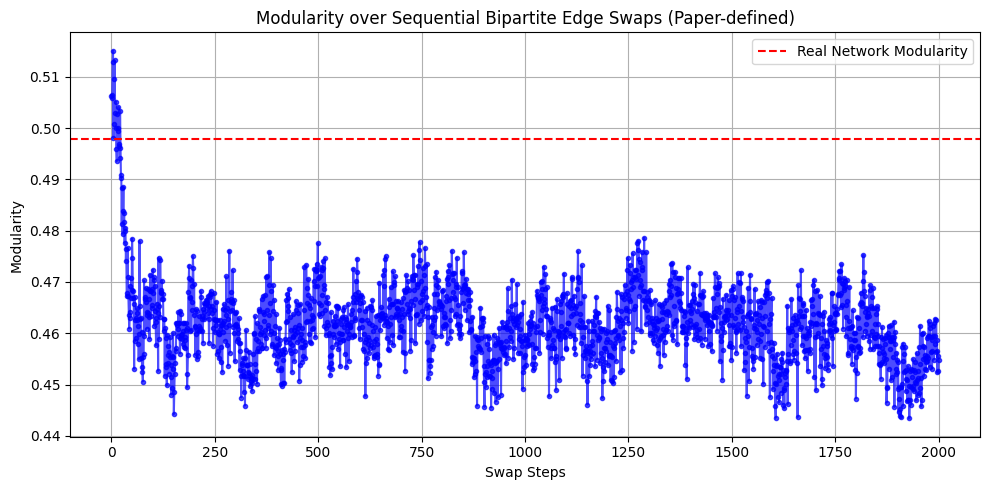

In [41]:
# Plot modularity trace over swap steps
plt.figure(figsize=(10, 5))
plt.plot(swap_modularities, marker='o', markersize=3, linestyle='-', color='blue', alpha=0.7)
plt.axhline(y=modularity_value, color='red', linestyle='--', label='Real Network Modularity')
plt.title('Modularity over Sequential Bipartite Edge Swaps (Paper-defined)')
plt.xlabel('Swap Steps')
plt.ylabel('Modularity')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [42]:
# Sequential pollinator-weighted edge swaps (allowing multigraph) and modularity tracking
import random
from networkx.algorithms.community import louvain_communities
from networkx.algorithms.community.quality import modularity

# Start from original graph (copy). Use a MultiGraph to allow parallel edges after swaps.
g_swap = nx.MultiGraph()
g_swap.add_nodes_from(B.nodes(data=True))
for u, v, data in B.edges(data=True):
    g_swap.add_edge(u, v, **{k: data[k] for k in data})

plants_set = set(plants)
pollinators_list = [q for q in pollinators]  # preserve order for weighted sampling

num_steps = 1000
swap_modularities = []
base_seed = 47524
rng = random.Random(base_seed)

def pick_edge():
    # pick two random elements from the edge list
    if g_swap.number_of_edges() < 2:
        return None
    edges = list(g_swap.edges())
    return rng.sample(edges, 1)[0]

def multigraph_simple_view(Gm: nx.MultiGraph) -> nx.Graph:
    """Collapse parallel edges into a simple weighted graph (weight = multiplicity)."""
    Gs = nx.Graph()
    for u, v in Gm.edges():
        if Gs.has_edge(u, v):
            Gs[u][v]['weight'] += 1
        else:
            Gs.add_edge(u, v, weight=1)
    return Gs

# Initial modularity
Gs0 = multigraph_simple_view(g_swap)
init_comms = louvain_communities(Gs0, weight='weight', seed=base_seed)
init_mod = modularity(Gs0, init_comms, weight='weight')
swap_modularities.append(init_mod)

for step in range(1, num_steps + 1):
    edge1 = pick_edge()
    edge2 = pick_edge()
    if edge1 is not None and edge2 is not None:
        p1, q1 = edge1
        p2, q2 = edge2
        # If edges identical, do nothing (graph unchanged)
        if not (p1 == p2 and q1 == q2):
            # Remove one instance of each original edge
            try:
                g_swap.remove_edge(p1, q1)
            except Exception:
                pass
            try:
                g_swap.remove_edge(p2, q2)
            except Exception:
                pass
            # Add swapped edges (allow parallel edges)
            g_swap.add_edge(p1, q2)
            g_swap.add_edge(p2, q1)
    # Compute modularity on collapsed simple weighted view
    Gs = multigraph_simple_view(g_swap)
    comms = louvain_communities(Gs, weight='weight', seed=base_seed + step)
    m_val = modularity(Gs, comms, weight='weight')
    swap_modularities.append(m_val)

print(f"Pollinator-weighted swaps complete: {num_steps} steps. Values stored: {len(swap_modularities)} (incl. initial).")
print(f"Initial modularity: {swap_modularities[0]:.4f}; Final modularity: {swap_modularities[-1]:.4f}")

Pollinator-weighted swaps complete: 1000 steps. Values stored: 1001 (incl. initial).
Initial modularity: 0.5061; Final modularity: 0.4980


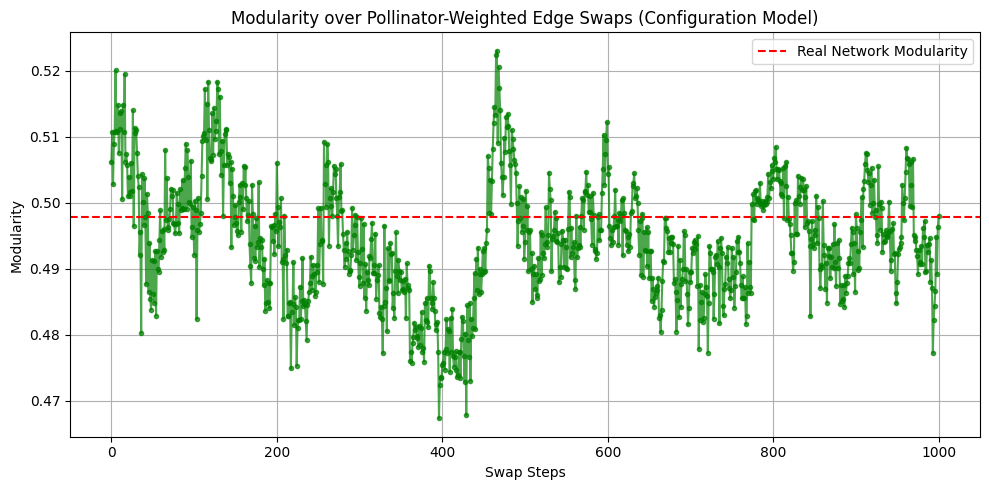

In [43]:
# Plot modularity trace over pollinator-weighted swaps
plt.figure(figsize=(10, 5))
plt.plot(swap_modularities, marker='o', markersize=3, linestyle='-', color='green', alpha=0.7)
plt.axhline(y=modularity_value, color='red', linestyle='--', label='Real Network Modularity')
plt.title('Modularity over Pollinator-Weighted Edge Swaps (Configuration Model)')
plt.xlabel('Swap Steps')
plt.ylabel('Modularity')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

In [44]:
import networkx as nx

# Assumption: the edge list file is in the current working directory or a relative path.
# Adjust 'filename' if the file resides in a subfolder (e.g., 'data/email-Eu-core.txt').
filename = 'C:\\Users\\YuxinLi\\Downloads\\Email-EuAll.txt'

# Load directed graph from edge list (whitespace-separated source target per line)
D = nx.read_edgelist(filename, create_using=nx.DiGraph(), nodetype=int)

# Identify largest strongly connected component (LCC)
components = nx.strongly_connected_components(D)
lcc_nodes = max(components, key=len)

# Create undirected subgraph of the LCC
G = D.subgraph(lcc_nodes).to_undirected().copy()

print(f"Original directed graph: nodes={D.number_of_nodes()}, edges={D.number_of_edges()}")
print(f"Largest strongly connected component: nodes={len(lcc_nodes)}")
print(f"Undirected LCC graph G: nodes={G.number_of_nodes()}, edges={G.number_of_edges()}")

Original directed graph: nodes=265214, edges=420045
Largest strongly connected component: nodes=34203
Undirected LCC graph G: nodes=34203, edges=97467


In [45]:
import scipy.sparse as sp
import scipy.sparse.linalg as spla

# --- Spectral Clustering Utilities ---

def compute_normalized_laplacian(G):
    """Return the symmetric normalized Laplacian L_sym = I - D^{-1/2} A D^{-1/2} as a sparse matrix.

    Parameters
    ----------
    G : networkx.Graph (undirected)
        Graph must be undirected (or treated as such) and without negative weights.
    """
    # Use NetworkX to get a consistent node ordering
    nodes = list(G.nodes())
    n = len(nodes)
    index = {u: i for i, u in enumerate(nodes)}

    # Build sparse adjacency
    data = []
    rows = []
    cols = []
    for u, v, d in G.edges(data=True):
        w = d.get('weight', 1.0)
        i = index[u]; j = index[v]
        rows.append(i); cols.append(j); data.append(w)
        rows.append(j); cols.append(i); data.append(w)  # ensure symmetry
    A = sp.coo_matrix((data, (rows, cols)), shape=(n, n)).tocsr()

    # Degree vector
    deg = np.array(A.sum(axis=1)).flatten()
    # Handle isolated nodes (shouldn't occur in LCC, but be robust)
    deg_safe = np.where(deg > 0, deg, 1.0)
    d_inv_sqrt = 1.0 / np.sqrt(deg_safe)

    D_inv_sqrt = sp.diags(d_inv_sqrt)
    # Normalized adjacency: D^{-1/2} A D^{-1/2}
    An = D_inv_sqrt @ A @ D_inv_sqrt
    # L = I - An
    L = sp.eye(n, format='csr') - An
    return L, nodes

def choose_k_by_eigengap(evals, max_k=20):
    """Heuristic: choose k maximizing the gap evals[i+1]-evals[i] among first max_k.

    evals should be sorted ascending.
    Returns (k, gaps) where k>=1.
    """
    m = min(len(evals)-1, max_k)
    gaps = evals[1:m+1] - evals[0:m]
    if len(gaps) == 0:
        return 1, gaps
    k = int(np.argmax(gaps) + 1)  # +1 because gap after eigenvalue i suggests k = i+1
    return k, gaps

def spectral_embedding(G, k=None, n_eigs=None, return_evals=False):
    """Compute spectral embedding (first k eigenvectors of normalized Laplacian).

    If k is None, we compute more eigenvalues (n_eigs or default) and use eigengap.
    """
    L, nodes = compute_normalized_laplacian(G)
    n = L.shape[0]

    if n_eigs is None:
        # request a modest number of eigenpairs for gap detection
        n_eigs = min(50, n-1)  # cannot exceed n-1 for eigsh
    n_eigs = max(n_eigs, 2)
    k_lanczos = min(n_eigs, n-1)

    # Compute the smallest eigenvalues/eigenvectors
    evals, evecs = spla.eigsh(L, k=k_lanczos, which='SM')
    order = np.argsort(evals)
    evals = evals[order]
    evecs = evecs[:, order]

    chosen_k = k
    if k is None:
        chosen_k, _ = choose_k_by_eigengap(evals, max_k=min(20, len(evals)-1))

    embedding = evecs[:, :chosen_k]
    # Row-normalize embedding (common practice)
    row_norms = np.linalg.norm(embedding, axis=1, keepdims=True)
    row_norms[row_norms == 0] = 1.0
    embedding = embedding / row_norms

    if return_evals:
        return embedding, nodes, evals, evecs
    return embedding, nodes

def spectral_clustering(G, k=None, n_eigs=None, random_state=0):
    """Perform spectral clustering on graph G.

    Returns: labels (array aligned with list(G.nodes())).
    """
    embedding, nodes, evals, evecs = spectral_embedding(G, k=k, n_eigs=n_eigs, return_evals=True)
    if k is None:
        # k inferred inside spectral_embedding as embedding.shape[1]
        k = embedding.shape[1]
    km = KMeans(n_clusters=k, n_init=10, random_state=random_state)
    labels = km.fit_predict(embedding)
    return labels, nodes, evals, evecs

print("Spectral clustering utility functions defined.")

Spectral clustering utility functions defined.


In [46]:
# --- Compute a batch of smallest eigenvalues for eigengap inspection ---
# Select how many eigenpairs to compute (keep modest to control runtime)
num_eigs_for_plot = 50  # adjust depending on graph size

L, node_order = compute_normalized_laplacian(G)
# Ensure we don't request more eigenpairs than n-1
k_req = min(num_eigs_for_plot, L.shape[0]-1)
print(f"Computing {k_req} smallest eigenpairs of normalized Laplacian (n={L.shape[0]}) ...")
vals, vecs = spla.eigsh(L, k=k_req, which='SM')
order = np.argsort(vals)
vals = vals[order]
vecs = vecs[:, order]

suggested_k, gaps = choose_k_by_eigengap(vals, max_k=min(20, len(vals)-1))
print(f"Suggested k by eigengap heuristic: {suggested_k}")

# Store for later steps
lap_eigenvalues = vals
lap_eigenvectors = vecs

Computing 50 smallest eigenpairs of normalized Laplacian (n=34203) ...
Suggested k by eigengap heuristic: 1


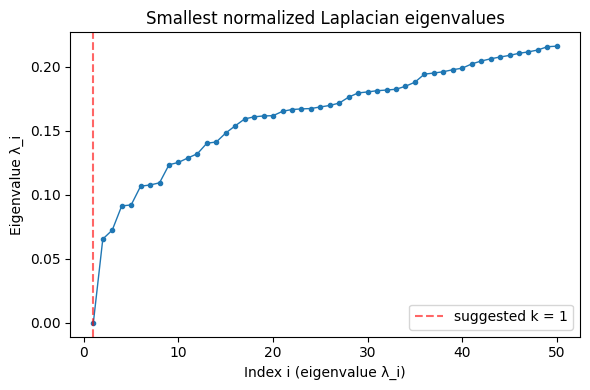

λ_1 = 0.000000
λ_2 = 0.065365
λ_3 = 0.072370
λ_4 = 0.091239
λ_5 = 0.092017
λ_6 = 0.106663
λ_7 = 0.107584
λ_8 = 0.109290
λ_9 = 0.123382
λ_10 = 0.125238


In [47]:
import matplotlib.pyplot as plt

# --- Plot sorted eigenvalues to inspect eigengap ---
vals = lap_eigenvalues
fig, ax = plt.subplots(figsize=(6,4))
ax.plot(range(1, len(vals)+1), vals, marker='o', ms=3, lw=1)
ax.set_xlabel('Index i (eigenvalue λ_i)')
ax.set_ylabel('Eigenvalue λ_i')
ax.set_title('Smallest normalized Laplacian eigenvalues')

# Annotate suggested k
ax.axvline(suggested_k, color='red', linestyle='--', alpha=0.6, label=f'suggested k = {suggested_k}')
ax.legend()
plt.tight_layout()
plt.show()

# Optional: show first few eigenvalues numerically
for i, v in enumerate(vals[:10], start=1):
    print(f"λ_{i} = {v:.6f}")

In [48]:
# --- Spectral clustering with first 8 eigenvectors ---
from collections import Counter

k = 8  # number of communities
if 'lap_eigenvectors' not in globals():
    raise RuntimeError("lap_eigenvectors not found. Run the eigenvalue computation cell first.")

if lap_eigenvectors.shape[1] < k:
    raise ValueError(f"Only {lap_eigenvectors.shape[1]} eigenvectors available; cannot use first {k}.")

embedding8 = lap_eigenvectors[:, :k]
# Row-normalize (helps k-means stability)
row_norms = np.linalg.norm(embedding8, axis=1, keepdims=True)
row_norms[row_norms == 0] = 1.0
embedding8 = embedding8 / row_norms

kmeans8 = KMeans(n_clusters=k, n_init=20, random_state=0)
labels8 = kmeans8.fit_predict(embedding8)

# Map back to original node labels using node_order captured earlier
node_to_community = {node: int(lbl) for node, lbl in zip(node_order, labels8)}

print("Cluster size distribution:", Counter(labels8))
print("Example assignments (first 10):", list(node_to_community.items())[:10])

# The dictionary mapping each node to its community label is the final result.
list(node_to_community.items())[:10]

Cluster size distribution: Counter({np.int32(3): 12090, np.int32(0): 10876, np.int32(7): 7703, np.int32(2): 1160, np.int32(4): 836, np.int32(5): 654, np.int32(1): 563, np.int32(6): 321})
Example assignments (first 10): [(1, 0), (3, 3), (5, 6), (8, 3), (10, 5), (11, 0), (131083, 0), (15, 0), (19, 7), (20, 0)]


[(1, 0),
 (3, 3),
 (5, 6),
 (8, 3),
 (10, 5),
 (11, 0),
 (131083, 0),
 (15, 0),
 (19, 7),
 (20, 0)]

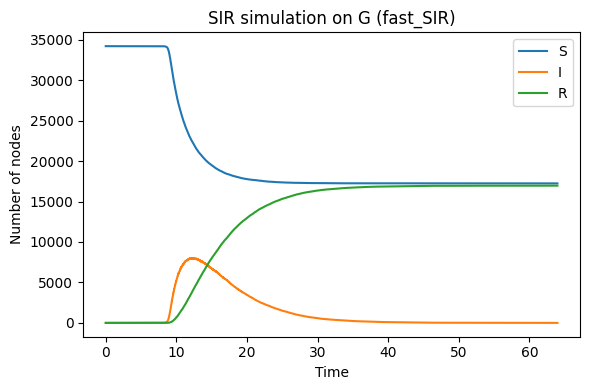

np.int64(16962)

In [49]:
# --- Simple SIR simulation using EoN.fast_SIR ---
import EoN, random
import matplotlib.pyplot as plt

# Parameters (adjust as desired)
tau = .10   # transmission rate per SI edge
gamma = 0.2  # recovery rate

# Pick one random initial infected node
initial_infecteds = [random.choice(list(G.nodes()))]

# Run fast SIR simulation (returns time series of S,I,R counts)
t, S, I, R = EoN.fast_SIR(G, tau, gamma, initial_infecteds, return_full_data=False)

# Plot S, I, R vs time
plt.figure(figsize=(6,4))
plt.plot(t, S, label='S')
plt.plot(t, I, label='I')
plt.plot(t, R, label='R')
plt.xlabel('Time')
plt.ylabel('Number of nodes')
plt.title('SIR simulation on G (fast_SIR)')
plt.legend()
plt.tight_layout()
plt.show()

# Final epidemic size (total recovered)
R[-1]

Removed 25 high-degree nodes. Remaining nodes: 34178
Runs: 100
Peak time: mean=3.00, std=3.61
Peak height: mean=3042.68, std=3502.90
Final size: mean=6561.22, std=7555.78


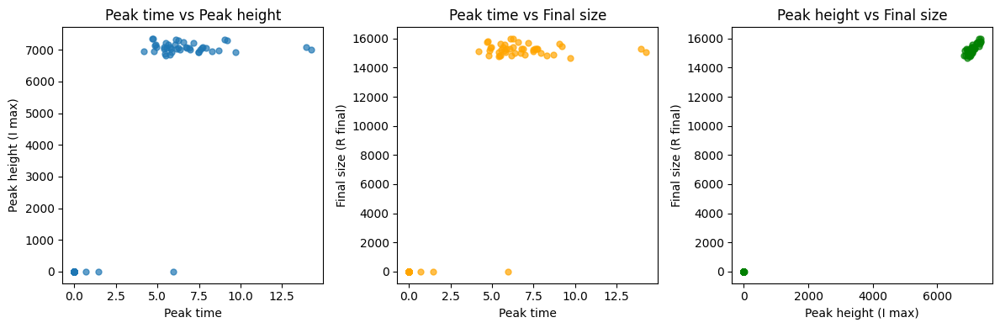

In [53]:
# --- Immunization strategy (remove high-degree nodes) & repeated SIR simulations ---
import EoN, random, numpy as np
from heapq import nlargest

N = 25  # immunization budget (number of nodes to remove)

# Degree centrality (here just use degree counts, no normalization needed for ranking)
degrees = dict(G.degree())
# Select top-N nodes by degree
high_degree_nodes = [node for node, _ in nlargest(N, degrees.items(), key=lambda kv: kv[1])]

# Create reduced graph by removing immunized nodes
G_reduced = G.copy()
G_reduced.remove_nodes_from(high_degree_nodes)
print(f"Removed {len(high_degree_nodes)} high-degree nodes. Remaining nodes: {G_reduced.number_of_nodes()}")

# SIR parameters (reuse earlier style; adjust if desired)
tau = 0.10
gamma = 0.2

num_runs = 100
peak_times = []
peak_heights = []
final_sizes = []

nodes_list = list(G_reduced.nodes())
for run in range(num_runs):
    if not nodes_list:
        break
    initial_infecteds = [random.choice(nodes_list)]
    t, S, I, R = EoN.fast_SIR(G_reduced, tau, gamma, initial_infecteds, return_full_data=False)
    I_arr = np.array(I)
    peak_idx = int(I_arr.argmax())
    peak_times.append(t[peak_idx])
    peak_heights.append(I_arr[peak_idx])
    final_sizes.append(R[-1])

# Aggregate simple statistics
print(f"Runs: {len(peak_times)}")
print(f"Peak time: mean={np.mean(peak_times):.2f}, std={np.std(peak_times):.2f}")
print(f"Peak height: mean={np.mean(peak_heights):.2f}, std={np.std(peak_heights):.2f}")
print(f"Final size: mean={np.mean(final_sizes):.2f}, std={np.std(final_sizes):.2f}")

# Store results for further analysis
immunization_results = {
    'removed_nodes': high_degree_nodes,
    'peak_times': peak_times,
    'peak_heights': peak_heights,
    'final_sizes': final_sizes,
}

# Display first few entries
{key: values[:5] if isinstance(values, list) else values for key, values in immunization_results.items()}

# --- Scatterplots of epidemiological summary statistics ---
import matplotlib.pyplot as plt
import numpy as np

pt = np.array(immunization_results['peak_times'])
ph = np.array(immunization_results['peak_heights'])
fs = np.array(immunization_results['final_sizes'])

fig, axes = plt.subplots(1, 3, figsize=(12,4))
axes[0].scatter(pt, ph, s=25, alpha=0.7)
axes[0].set_xlabel('Peak time')
axes[0].set_ylabel('Peak height (I max)')
axes[0].set_title('Peak time vs Peak height')

axes[1].scatter(pt, fs, s=25, alpha=0.7, color='orange')
axes[1].set_xlabel('Peak time')
axes[1].set_ylabel('Final size (R final)')
axes[1].set_title('Peak time vs Final size')

axes[2].scatter(ph, fs, s=25, alpha=0.7, color='green')
axes[2].set_xlabel('Peak height (I max)')
axes[2].set_ylabel('Final size (R final)')
axes[2].set_title('Peak height vs Final size')

plt.tight_layout()
plt.show()

Number of communities: 8
Removing top 3 nodes (by intra-community degree) per community (total <= 25)
Total nodes selected for immunization (community-based): 24
Remaining nodes after community immunization: 34179
Community immunization runs: 100
Final size (mean): 5525.15


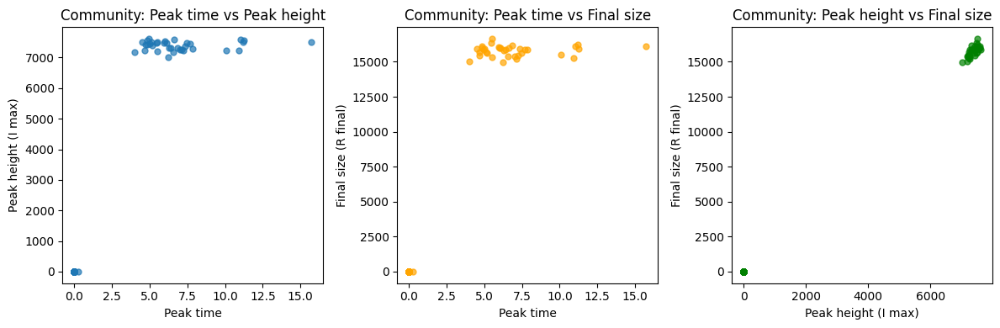

[192, 147, 868, 222, 536, 301, 1983, 219, 743, 10]

In [51]:
# --- Community-based immunization & SIR simulations ---
import EoN, random, numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict
from heapq import nlargest

N = 25  # total budget (reuse)

# Group nodes by community (assumes node_to_community exists)
community_nodes = defaultdict(list)
for node, c in node_to_community.items():
    community_nodes[c].append(node)

num_communities = len(community_nodes)
print(f"Number of communities: {num_communities}")

# Distribute budget across communities: remove K_per = floor(N / num_communities) per community
# If budget not divisible, we ignore remainder for simplicity (as per instruction style)
K_per = N // num_communities
print(f"Removing top {K_per} nodes (by intra-community degree) per community (total <= {N})")

community_removed = []
for c, nodes in community_nodes.items():
    # Induced subgraph of community
    subG = G.subgraph(nodes)
    # Degree inside community
    deg_sub = dict(subG.degree())
    top_nodes = [node for node, _ in nlargest(K_per, deg_sub.items(), key=lambda kv: kv[1])]
    community_removed.extend(top_nodes)

print(f"Total nodes selected for immunization (community-based): {len(community_removed)}")

# Create community-immunized graph
G_comm_reduced = G.copy()
G_comm_reduced.remove_nodes_from(community_removed)
print(f"Remaining nodes after community immunization: {G_comm_reduced.number_of_nodes()}")

# SIR parameters (reuse previous)
tau = 0.10
gamma = 0.2
num_runs = 100

peak_times_c = []
peak_heights_c = []
final_sizes_c = []

nodes_list_c = list(G_comm_reduced.nodes())
for run in range(num_runs):
    if not nodes_list_c:
        break
    initial_infecteds = [random.choice(nodes_list_c)]
    t, S, I, R = EoN.fast_SIR(G_comm_reduced, tau, gamma, initial_infecteds, return_full_data=False)
    I_arr = np.array(I)
    peak_idx = int(I_arr.argmax())
    peak_times_c.append(t[peak_idx])
    peak_heights_c.append(I_arr[peak_idx])
    final_sizes_c.append(R[-1])

print(f"Community immunization runs: {len(peak_times_c)}")
print(f"Final size (mean): {np.mean(final_sizes_c):.2f}")

community_immunization_results = {
    'removed_nodes': community_removed,
    'peak_times': peak_times_c,
    'peak_heights': peak_heights_c,
    'final_sizes': final_sizes_c,
}

# Scatterplots
pt = np.array(peak_times_c)
ph = np.array(peak_heights_c)
fs = np.array(final_sizes_c)
fig, axes = plt.subplots(1, 3, figsize=(12,4))
axes[0].scatter(pt, ph, s=25, alpha=0.7)
axes[0].set_xlabel('Peak time')
axes[0].set_ylabel('Peak height (I max)')
axes[0].set_title('Community: Peak time vs Peak height')

axes[1].scatter(pt, fs, s=25, alpha=0.7, color='orange')
axes[1].set_xlabel('Peak time')
axes[1].set_ylabel('Final size (R final)')
axes[1].set_title('Community: Peak time vs Final size')

axes[2].scatter(ph, fs, s=25, alpha=0.7, color='green')
axes[2].set_xlabel('Peak height (I max)')
axes[2].set_ylabel('Final size (R final)')
axes[2].set_title('Community: Peak height vs Final size')
plt.tight_layout()
plt.show()

# Show first few immunized nodes
community_removed[:10]

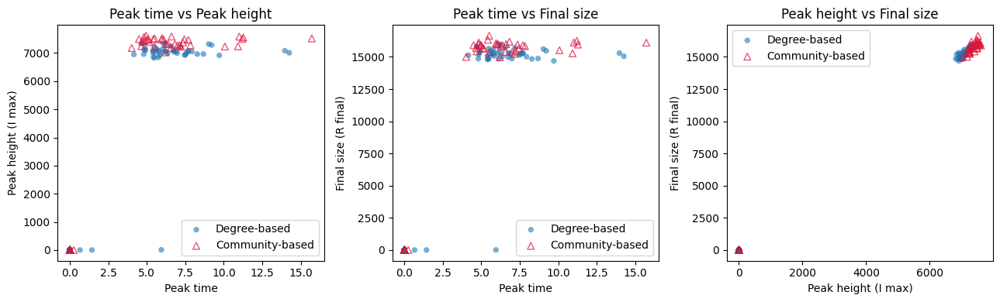

Degree-based final size mean ± std: 6561.22 ± 7555.78
Community-based final size mean ± std: 5525.15 ± 7531.30
Reduction (community vs degree) in mean final size: 1036.07


In [54]:
# --- Comparison of degree-based vs community-based immunization strategies ---
import numpy as np
import matplotlib.pyplot as plt

# Extract arrays for degree-based strategy
pt_deg = np.array(immunization_results['peak_times'])
ph_deg = np.array(immunization_results['peak_heights'])
fs_deg = np.array(immunization_results['final_sizes'])

# Extract arrays for community-based strategy
pt_com = np.array(community_immunization_results['peak_times'])
ph_com = np.array(community_immunization_results['peak_heights'])
fs_com = np.array(community_immunization_results['final_sizes'])

fig, axes = plt.subplots(1, 3, figsize=(13,4))

# Peak time vs Peak height
axes[0].scatter(pt_deg, ph_deg, s=28, alpha=0.6, marker='o', edgecolor='none', label='Degree-based')
axes[0].scatter(pt_com, ph_com, s=40, alpha=0.7, marker='^', facecolors='none', edgecolor='crimson', label='Community-based')
axes[0].set_xlabel('Peak time')
axes[0].set_ylabel('Peak height (I max)')
axes[0].set_title('Peak time vs Peak height')
axes[0].legend()

# Peak time vs Final size
axes[1].scatter(pt_deg, fs_deg, s=28, alpha=0.6, marker='o', edgecolor='none', label='Degree-based')
axes[1].scatter(pt_com, fs_com, s=40, alpha=0.7, marker='^', facecolors='none', edgecolor='crimson', label='Community-based')
axes[1].set_xlabel('Peak time')
axes[1].set_ylabel('Final size (R final)')
axes[1].set_title('Peak time vs Final size')
axes[1].legend()

# Peak height vs Final size
axes[2].scatter(ph_deg, fs_deg, s=28, alpha=0.6, marker='o', edgecolor='none', label='Degree-based')
axes[2].scatter(ph_com, fs_com, s=40, alpha=0.7, marker='^', facecolors='none', edgecolor='crimson', label='Community-based')
axes[2].set_xlabel('Peak height (I max)')
axes[2].set_ylabel('Final size (R final)')
axes[2].set_title('Peak height vs Final size')
axes[2].legend()

plt.tight_layout()
plt.show()

# Simple comparative summaries
print('Degree-based final size mean ± std: {:.2f} ± {:.2f}'.format(fs_deg.mean(), fs_deg.std()))
print('Community-based final size mean ± std: {:.2f} ± {:.2f}'.format(fs_com.mean(), fs_com.std()))
print('Reduction (community vs degree) in mean final size: {:.2f}'.format(fs_deg.mean() - fs_com.mean()))

In [55]:
# Load CSVs and preview
import pandas as pd
from IPython.display import display

# Adjust paths if the CSVs are in a different folder
gene_expression = pd.read_csv("C:\\Users\\YuxinLi\\Downloads\\gene_expression.csv")
sample_info = pd.read_csv("C:\\Users\\YuxinLi\\Downloads\\sample_info.csv")

# Show first few rows
print(gene_expression.head())
print(sample_info.head())

       Gene  GSM398074  GSM398076  GSM398078  GSM398080  GSM398082  GSM398084  \
0      SOX5  -0.349170   0.216571   0.471632   1.111919  -0.464774  -0.802632   
1     FGF16   0.862165   1.580481   0.320170   1.000122   0.137545  -0.045303   
2     PLCH2   0.082820  -0.594540   0.249374  -0.767722  -0.866090  -0.259950   
3  HSD17B14   0.593126   0.533182   0.344737   0.357976  -0.088431   0.066696   
4    IL18R1  -0.883210   1.019775   0.631391   0.900709  -1.757135  -1.509163   

   GSM398086  GSM398088  GSM398090  ...  GSM398139  GSM398141  GSM398143  \
0  -0.768370   0.065648   0.325431  ...   1.158330   1.735777  -0.136937   
1  -0.308148   0.981677   1.205572  ...  -0.489697   0.824923  -0.938846   
2  -0.071826  -0.289090  -1.459083  ...   0.567062   0.885176  -0.780857   
3  -2.022212   0.314454   0.370097  ...   0.953481   1.684645   0.004239   
4  -1.390184  -0.798503  -1.446279  ...   0.431494   0.888172   0.801184   

   GSM398145  GSM398147  GSM398149  GSM398153  GSM398155

In [56]:
# Compute gene-by-gene Pearson correlation matrix
X = gene_expression.set_index("Gene")
gene_corr = X.T.corr(method="pearson")

# Preview result
print(gene_corr.shape)
print(gene_corr.head())

(4000, 4000)
Gene          SOX5     FGF16     PLCH2  HSD17B14    IL18R1      CPB2  \
Gene                                                                   
SOX5      1.000000  0.568980  0.373357  0.325632  0.389464  0.167870   
FGF16     0.568980  1.000000  0.308031  0.309070  0.315312  0.304637   
PLCH2     0.373357  0.308031  1.000000  0.297872  0.324416  0.174493   
HSD17B14  0.325632  0.309070  0.297872  1.000000  0.420668  0.492982   
IL18R1    0.389464  0.315312  0.324416  0.420668  1.000000  0.429959   

Gene        TICAM1       SLK     BTNL3     PRRG3  ...    ZC3H7B     ZFHX3  \
Gene                                              ...                       
SOX5      0.070573  0.314972  0.331795  0.374938  ...  0.584071  0.330802   
FGF16    -0.125292  0.051683 -0.000771  0.210267  ...  0.299571  0.337987   
PLCH2     0.205036  0.474913  0.273783  0.450262  ...  0.566016  0.372249   
HSD17B14  0.170439  0.082115  0.337944 -0.036733  ...  0.269319  0.276632   
IL18R1    0.298649  

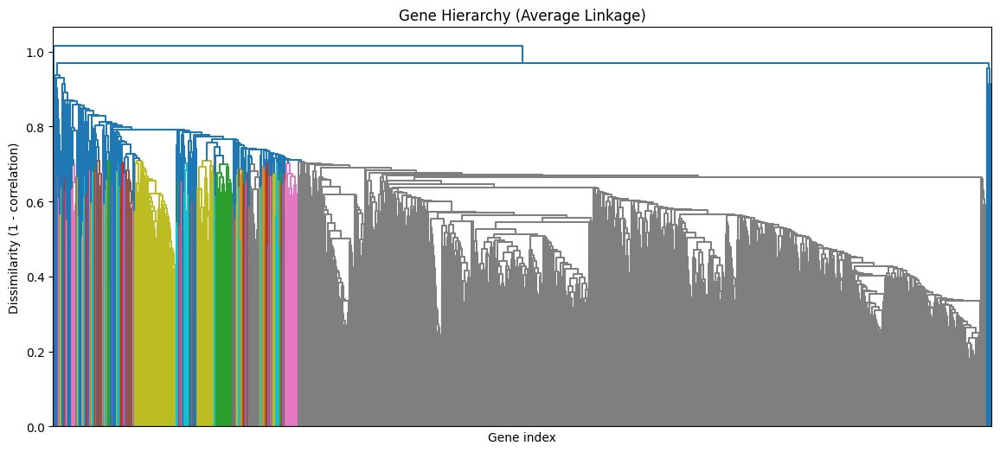

In [57]:
# Convert to dissimilarity and perform hierarchical clustering (average linkage)
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import linkage, dendrogram
from scipy.spatial.distance import squareform

# Dissimilarity: 1 - correlation
dissim = 1 - gene_corr

# Condensed distance vector for linkage
condensed = squareform(dissim.values, checks=False)

# Agglomerative clustering with 'average' linkage
Z = linkage(condensed, method="average")

# Plot dendrogram
plt.figure(figsize=(14, 6))
dendrogram(Z, no_labels=True)
plt.title("Gene Hierarchy (Average Linkage)")
plt.xlabel("Gene index")
plt.ylabel("Dissimilarity (1 - correlation)")
plt.show()

In [58]:
# Cut tree into modules (aim for ~10-20 modules) and map genes to module labels
import numpy as np
from scipy.cluster.hierarchy import fcluster

# Try a range of cut heights and pick the first that yields 10-20 modules
heights = np.linspace(0.3, 1.2, 20)
best_t = None
best_k = None
labels = None
for t in heights:
    labs = fcluster(Z, t=t, criterion="distance")
    k = labs.max()
    if 10 <= k <= 20:
        best_t = t
        best_k = k
        labels = labs
        break

# Fallback: force ~15 clusters if no suitable height found
if labels is None:
    labels = fcluster(Z, t=15, criterion="maxclust")
    best_k = labels.max()

# Create Series mapping gene -> module label
modules = pd.Series(labels, index=gene_corr.index, name="module")

# Preview
print("Number of modules:", best_k)
print(modules.value_counts().sort_index().head())
modules.head()

Number of modules: 17
module
1    3
2    2
3    2
4    6
5    2
Name: count, dtype: int64


Gene
SOX5        13
FGF16       13
PLCH2       13
HSD17B14    13
IL18R1      13
Name: module, dtype: int32

In [59]:
# Compute Module Eigengenes (first PC) and correlate with Progression
from sklearn.decomposition import PCA

# Expression matrix with genes as rows and samples as columns
# X shape: (n_genes, n_samples)
X = gene_expression.set_index("Gene")
print("X shape (genes x samples):", X.shape)

# Align progression vector to the exact sample order in X columns
# prog shape: (n_samples,)
prog = sample_info.set_index("Sample_ID").loc[X.columns, "Progression"]
print("Progression vector shape (samples,):", prog.shape)

# Compute module eigengenes (first principal component of each module's gene expression)
module_labels = sorted(modules.unique())
print("Number of modules:", len(module_labels))
ME = {}
for m in module_labels:
    # Genes assigned to this module
    genes_m = modules[modules == m].index
    print(f"Module {m}: genes = {len(genes_m)}")

    # Subset expression to these genes and transpose so rows are samples
    # Xm shape: (n_samples, n_genes_in_module)
    Xm = X.loc[genes_m].T
    print("  Xm shape (samples x genes):", Xm.shape)

    # Fit PCA and then transform (split steps for clarity)
    pca = PCA(n_components=1)
    pca.fit(Xm)
    me = pca.transform(Xm).ravel()  # me shape: (n_samples,)
    print("  ME shape (samples,):", me.shape)

    # Store as a Series indexed by sample ID; column will be this module's eigengene
    ME[m] = pd.Series(me, index=Xm.index, name=f"ME{m}")

# Combine all module eigengenes into a single DataFrame
# module_eigengenes shape: (n_samples, n_modules)
module_eigengenes = pd.DataFrame(ME)
print("module_eigengenes shape (samples x modules):", module_eigengenes.shape)

# Pearson correlation between each module eigengene and the Progression trait
module_progression_corr = module_eigengenes.apply(lambda s: s.corr(prog, method="pearson"))
print("Pearson correlation (Module Eigengene vs Progression):")
print(module_progression_corr.sort_index())

X shape (genes x samples): (4000, 112)
Progression vector shape (samples,): (112,)
Number of modules: 17
Module 1: genes = 3
  Xm shape (samples x genes): (112, 3)
  ME shape (samples,): (112,)
Module 2: genes = 2
  Xm shape (samples x genes): (112, 2)
  ME shape (samples,): (112,)
Module 3: genes = 2
  Xm shape (samples x genes): (112, 2)
  ME shape (samples,): (112,)
Module 4: genes = 6
  Xm shape (samples x genes): (112, 6)
  ME shape (samples,): (112,)
Module 5: genes = 2
  Xm shape (samples x genes): (112, 2)
  ME shape (samples,): (112,)
Module 6: genes = 22
  Xm shape (samples x genes): (112, 22)
  ME shape (samples,): (112,)
Module 7: genes = 1
  Xm shape (samples x genes): (112, 1)
  ME shape (samples,): (112,)
Module 8: genes = 3
  Xm shape (samples x genes): (112, 3)
  ME shape (samples,): (112,)
Module 9: genes = 3
  Xm shape (samples x genes): (112, 3)
  ME shape (samples,): (112,)
Module 10: genes = 9
  Xm shape (samples x genes): (112, 9)
  ME shape (samples,): (112,)
Mo

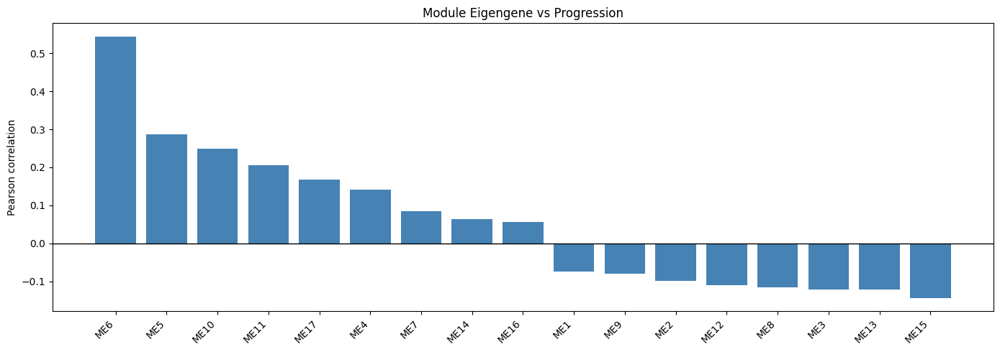

In [60]:
# Bar chart: Module Eigengene correlations with Progression
import matplotlib.pyplot as plt

corr = module_progression_corr.sort_values(ascending=False)
labels = [f"ME{int(m)}" for m in corr.index]

plt.figure(figsize=(14, 5))
plt.bar(range(len(corr)), corr.values, color="steelblue")
plt.axhline(0, color="black", linewidth=1)
plt.xticks(range(len(corr)), labels, rotation=45, ha="right")
plt.ylabel("Pearson correlation")
plt.title("Module Eigengene vs Progression")
plt.tight_layout()
plt.show()